<a href="https://colab.research.google.com/github/Purnata26/scikit/blob/master/lab_label(purno).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
lab_data=pd.read_csv('/content/drive/My Drive/Nurse/Lab/labels_lab_2users.csv')
lab_data

,user_id,act_id,start,finish
0,19,1,8/22/2018 11:06,8/22/2018 11:06
1,19,1,8/22/2018 11:18,8/22/2018 11:18
2,19,1,8/22/2018 11:19,8/22/2018 11:19
3,1,1,7/25/2018 12:24,7/25/2018 12:24
4,1,1,7/25/2018 12:26,7/25/2018 12:27
...,...,...,...,...
418,19,12,8/22/2018 17:08,8/22/2018 17:08
419,19,12,8/22/2018 17:09,8/22/2018 17:09
420,19,12,8/22/2018 17:10,8/22/2018 17:10
421,19,12,8/22/2018 17:09,8/22/2018 17:09


In [ ]:
lab_data.isna().sum()

user_id    0
act_id     0
start      0
finish     0
dtype: int64

In [ ]:
lab_data1=lab_data.loc[(lab_data.user_id==1)]
lab_data19=lab_data.loc[(lab_data.user_id==19)]
print(lab_data1.shape)

print(lab_data19.shape)

(121, 4)
(302, 4)


In [ ]:
lab_data1=lab_data1.drop_duplicates(subset=['start','finish'])
lab_data19=lab_data19.drop_duplicates(subset=['start','finish'])

In [ ]:
print(lab_data1.shape,lab_data19.shape)

(110, 4) (276, 4)


In [ ]:
lab_data1.sort_values(['start' , 'finish'] , ascending=[True , True] ,inplace = True , ignore_index=True)
lab_data19.sort_values(['start' , 'finish'] , ascending=[True , True] ,inplace = True , ignore_index=True)

In [ ]:
lab_data1.head()

,user_id,act_id,start,finish
0,1,1,7/25/2018 12:24,7/25/2018 12:24
1,1,1,7/25/2018 12:26,7/25/2018 12:27
2,1,1,7/25/2018 12:27,7/25/2018 12:28
3,1,1,7/25/2018 12:29,7/25/2018 12:29
4,1,1,7/25/2018 12:30,7/25/2018 12:30


In [ ]:
lab_data1['start'] = pd.to_datetime(lab_data1.start,utc=True)
lab_data1['finish'] = pd.to_datetime(lab_data1.finish,utc=True)
for i in range(len(lab_data1)):
  if lab_data1.start[i] == lab_data1.finish[i]:
    lab_data1.loc[i,'start']=lab_data1.start[i]-pd.Timedelta('9h')
    lab_data1.loc[i,'finish'] = lab_data1.finish[i] + pd.Timedelta('59s')-pd.Timedelta('9h')
lab_data1

,user_id,act_id,start,finish
0,1,1,2018-07-25 03:24:00+00:00,2018-07-25 03:24:59+00:00
1,1,1,2018-07-25 12:26:00+00:00,2018-07-25 12:27:00+00:00
2,1,1,2018-07-25 12:27:00+00:00,2018-07-25 12:28:00+00:00
3,1,1,2018-07-25 03:29:00+00:00,2018-07-25 03:29:59+00:00
4,1,1,2018-07-25 03:30:00+00:00,2018-07-25 03:30:59+00:00
...,...,...,...,...
105,1,12,2018-07-25 08:17:00+00:00,2018-07-25 08:17:59+00:00
106,1,12,2018-07-25 17:17:00+00:00,2018-07-25 17:18:00+00:00
107,1,12,2018-07-25 08:18:00+00:00,2018-07-25 08:18:59+00:00
108,1,12,2018-07-25 17:18:00+00:00,2018-07-25 17:19:00+00:00


In [ ]:
lab_data19['start'] = pd.to_datetime(lab_data19.start,utc=True)
lab_data19['finish'] = pd.to_datetime(lab_data19.finish,utc=True)
for i in range(len(lab_data19)):
  if lab_data19.start[i] == lab_data19.finish[i]:
    lab_data19.loc[i,'start']=lab_data19.start[i]-pd.Timedelta('9h')
    lab_data19.loc[i,'finish'] = lab_data19.finish[i] + pd.Timedelta('59s')-pd.Timedelta('9h')
lab_data19


,user_id,act_id,start,finish
0,19,1,2018-08-22 02:06:00+00:00,2018-08-22 02:06:59+00:00
1,19,1,2018-08-22 02:18:00+00:00,2018-08-22 02:18:59+00:00
2,19,1,2018-08-22 02:19:00+00:00,2018-08-22 02:19:59+00:00
3,19,2,2018-08-22 11:20:00+00:00,2018-08-22 11:21:00+00:00
4,19,2,2018-08-22 02:27:00+00:00,2018-08-22 02:27:59+00:00
...,...,...,...,...
271,19,12,2018-08-23 06:13:00+00:00,2018-08-23 06:13:59+00:00
272,19,12,2018-08-23 15:13:00+00:00,2018-08-23 15:14:00+00:00
273,19,12,2018-08-23 06:14:00+00:00,2018-08-23 06:14:59+00:00
274,19,12,2018-08-23 15:14:00+00:00,2018-08-23 15:15:00+00:00


In [ ]:
pip install datetimerange

In [ ]:
from datetimerange import DateTimeRange
import numpy as np
import datetime
def get_timerange(start,finish):
  time_range=[]
  for t in np.arange(len(start)):
    time=DateTimeRange(str(start[t]),str(finish[t]))
    time_range.append(str(time))

  return time_range

In [ ]:
lab_data1['datetimerange']=get_timerange(lab_data1['start'],lab_data1['finish'])
pd.set_option('display.max_rows',200)
lab_data1

,user_id,act_id,start,finish,datetimerange
0,1,1,2018-07-25 03:24:00+00:00,2018-07-25 03:24:59+00:00,2018-07-25T03:24:00+0000 - 2018-07-25T03:24:59...
1,1,1,2018-07-25 12:26:00+00:00,2018-07-25 12:27:00+00:00,2018-07-25T12:26:00+0000 - 2018-07-25T12:27:00...
2,1,1,2018-07-25 12:27:00+00:00,2018-07-25 12:28:00+00:00,2018-07-25T12:27:00+0000 - 2018-07-25T12:28:00...
3,1,1,2018-07-25 03:29:00+00:00,2018-07-25 03:29:59+00:00,2018-07-25T03:29:00+0000 - 2018-07-25T03:29:59...
4,1,1,2018-07-25 03:30:00+00:00,2018-07-25 03:30:59+00:00,2018-07-25T03:30:00+0000 - 2018-07-25T03:30:59...
5,1,2,2018-07-25 12:32:00+00:00,2018-07-25 12:33:00+00:00,2018-07-25T12:32:00+0000 - 2018-07-25T12:33:00...
6,1,2,2018-07-25 03:36:00+00:00,2018-07-25 03:36:59+00:00,2018-07-25T03:36:00+0000 - 2018-07-25T03:36:59...
7,1,2,2018-07-25 12:37:00+00:00,2018-07-25 12:38:00+00:00,2018-07-25T12:37:00+0000 - 2018-07-25T12:38:00...
8,1,2,2018-07-25 12:38:00+00:00,2018-07-25 12:39:00+00:00,2018-07-25T12:38:00+0000 - 2018-07-25T12:39:00...
9,1,2,2018-07-25 12:39:00+00:00,2018-07-25 12:40:00+00:00,2018-07-25T12:39:00+0000 - 2018-07-25T12:40:00...


In [ ]:

lab_data19['datetimerange']=get_timerange(lab_data19['start'],lab_data19['finish'])
lab_data19

,user_id,act_id,start,finish,datetimerange
0,19,1,2018-08-22 02:06:00+00:00,2018-08-22 02:06:59+00:00,2018-08-22T02:06:00+0000 - 2018-08-22T02:06:59...
1,19,1,2018-08-22 02:18:00+00:00,2018-08-22 02:18:59+00:00,2018-08-22T02:18:00+0000 - 2018-08-22T02:18:59...
2,19,1,2018-08-22 02:19:00+00:00,2018-08-22 02:19:59+00:00,2018-08-22T02:19:00+0000 - 2018-08-22T02:19:59...
3,19,2,2018-08-22 11:20:00+00:00,2018-08-22 11:21:00+00:00,2018-08-22T11:20:00+0000 - 2018-08-22T11:21:00...
4,19,2,2018-08-22 02:27:00+00:00,2018-08-22 02:27:59+00:00,2018-08-22T02:27:00+0000 - 2018-08-22T02:27:59...
...,...,...,...,...,...
271,19,12,2018-08-23 06:13:00+00:00,2018-08-23 06:13:59+00:00,2018-08-23T06:13:00+0000 - 2018-08-23T06:13:59...
272,19,12,2018-08-23 15:13:00+00:00,2018-08-23 15:14:00+00:00,2018-08-23T15:13:00+0000 - 2018-08-23T15:14:00...
273,19,12,2018-08-23 06:14:00+00:00,2018-08-23 06:14:59+00:00,2018-08-23T06:14:00+0000 - 2018-08-23T06:14:59...
274,19,12,2018-08-23 15:14:00+00:00,2018-08-23 15:15:00+00:00,2018-08-23T15:14:00+0000 - 2018-08-23T15:15:00...


In [ ]:
raw_data=pd.read_csv('/content/drive/My Drive/Nurse/Lab/bigact_raw_lab_acc.csv')
raw_data.head()

,user_id,datetime,x,y,z
0,1,2018-07-25T14:58:46.247+1000,0.612,7.7,0.0
1,1,2018-07-25T14:55:30.396+1000,5.286,7.7,0.0
2,1,2018-07-25T14:55:30.402+1000,5.286,7.7,0.0
3,1,2018-07-25T14:58:46.247+1000,0.612,7.7,0.0
4,1,2018-07-25T14:55:30.396+1000,5.286,7.7,0.0


In [ ]:
raw_1=raw_data.loc[(raw_data.user_id==1)]
raw_19=raw_data.loc[(raw_data.user_id==19)]

In [ ]:
print(raw_1.shape,raw_19.shape)

(483420, 5) (581063, 5)


In [ ]:
raw_1=raw_1.drop_duplicates(subset='datetime')
raw_19=raw_19.drop_duplicates(subset='datetime')
print(raw_1.shape,raw_19.shape)

(143514, 5) (473827, 5)


In [ ]:
raw_1.sort_values(['datetime'] , inplace = True , ignore_index=True)
raw_19.sort_values(['datetime'] , inplace = True,ignore_index=True)

In [ ]:
pd.set_option('display.max_rows',100000)
raw_1.head(100000)

,user_id,datetime,x,y,z
0,1,2018-07-25T11:13:51.761+1000,-0.268,0.727,9.778
1,1,2018-07-25T11:13:51.772+1000,-0.268,0.727,9.778
2,1,2018-07-25T11:13:51.979+1000,-0.268,0.727,9.777
3,1,2018-07-25T11:13:52.105+1000,-0.268,0.689,9.777
4,1,2018-07-25T11:13:52.112+1000,-0.268,0.689,9.777
5,1,2018-07-25T11:13:52.301+1000,-0.229,0.689,9.776
6,1,2018-07-25T11:13:52.311+1000,-0.229,0.689,9.776
7,1,2018-07-25T11:13:52.501+1000,-0.268,0.612,9.776
8,1,2018-07-25T11:13:52.701+1000,-0.268,0.727,9.775
9,1,2018-07-25T11:13:52.901+1000,-0.229,0.727,9.776


In [ ]:
raw_19

,user_id,datetime,x,y,z
0,19,2018-08-21T19:54:42.669+0900,-2.834,2.260,9.316
1,19,2018-08-21T19:54:42.724+0900,-3.332,2.528,9.280
2,19,2018-08-21T19:54:42.804+0900,-3.102,2.796,9.125
3,19,2018-08-21T19:54:42.862+0900,-2.566,2.911,9.018
4,19,2018-08-21T19:54:42.901+0900,-2.106,3.217,9.053
...,...,...,...,...,...
473822,19,2018-08-23T20:42:24.589+0900,-3.830,4.788,8.717
473823,19,2018-08-23T20:42:24.762+0900,-5.056,4.558,7.105
473824,19,2018-08-23T20:42:24.977+0900,-5.899,4.367,6.489
473825,19,2018-08-23T20:42:24.993+0900,-5.899,4.367,6.489


In [ ]:
import datetime
raw_1['datetime'] = pd.to_datetime(raw_1.datetime,utc=True)
raw_1

,user_id,datetime,x,y,z
0,1,2018-07-25 01:13:51.761000+00:00,-0.268,0.727,9.778
1,1,2018-07-25 01:13:51.772000+00:00,-0.268,0.727,9.778
2,1,2018-07-25 01:13:51.979000+00:00,-0.268,0.727,9.777
3,1,2018-07-25 01:13:52.105000+00:00,-0.268,0.689,9.777
4,1,2018-07-25 01:13:52.112000+00:00,-0.268,0.689,9.777
...,...,...,...,...,...
143509,1,2018-08-21 05:21:50.950000+00:00,0.222,-1.172,10.116
143510,1,2018-08-21 05:21:50.988000+00:00,0.253,-1.146,10.147
143511,1,2018-08-21 05:21:51.069000+00:00,0.245,-1.145,10.032
143512,1,2018-08-21 05:21:51.152000+00:00,0.214,-1.173,10.055


In [ ]:
raw_19['datetime'] = pd.to_datetime(raw_19.datetime,utc=True)
raw_19

,user_id,datetime,x,y,z
0,19,2018-08-21 10:54:42.669000+00:00,-2.834,2.260,9.316
1,19,2018-08-21 10:54:42.724000+00:00,-3.332,2.528,9.280
2,19,2018-08-21 10:54:42.804000+00:00,-3.102,2.796,9.125
3,19,2018-08-21 10:54:42.862000+00:00,-2.566,2.911,9.018
4,19,2018-08-21 10:54:42.901000+00:00,-2.106,3.217,9.053
...,...,...,...,...,...
473822,19,2018-08-23 11:42:24.589000+00:00,-3.830,4.788,8.717
473823,19,2018-08-23 11:42:24.762000+00:00,-5.056,4.558,7.105
473824,19,2018-08-23 11:42:24.977000+00:00,-5.899,4.367,6.489
473825,19,2018-08-23 11:42:24.993000+00:00,-5.899,4.367,6.489


Text(0, 0.5, 'activity')

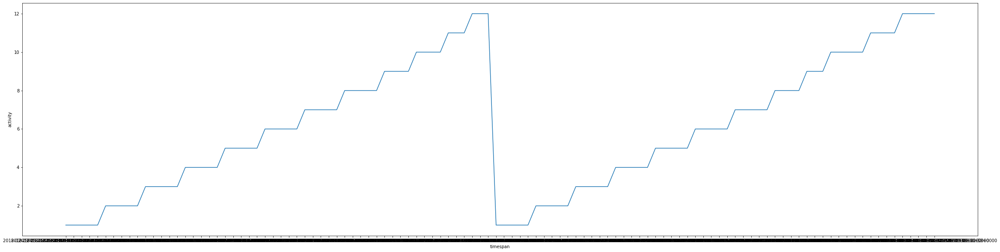

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(40,10))
plt.plot(lab_data1.datetimerange,lab_data1.act_id)
plt.xlabel('timespan')
plt.ylabel('activity')

Text(0, 0.5, 'activity')

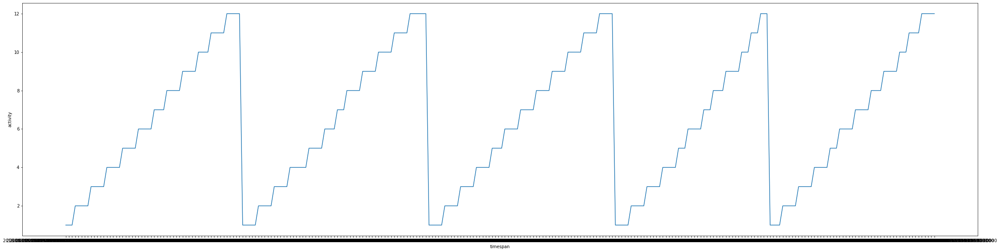

In [ ]:

plt.figure(figsize=(40,10))
plt.plot(lab_data19.datetimerange,lab_data19.act_id)
plt.xlabel('timespan')
plt.ylabel('activity')

In [ ]:
for _, row in lab_data1.iterrows():
  user_1 = raw_1[((raw_1['datetime'] >= row['start']) & (raw_1['datetime'] <= row['finish']))]
  raw_1.loc[ user_1.index ,'label'] = row['act_id']
  raw_1.loc[ user_1.index , 'starting'] = row['start']
  raw_1.loc[ user_1.index , 'finishing'] = row['finish']
raw_1

,user_id,datetime,x,y,z,label,starting,finishing
0,1,2018-07-25 01:13:51.761000+00:00,-0.268,0.727,9.778,NaN,NaN,NaN
1,1,2018-07-25 01:13:51.772000+00:00,-0.268,0.727,9.778,NaN,NaN,NaN
2,1,2018-07-25 01:13:51.979000+00:00,-0.268,0.727,9.777,NaN,NaN,NaN
3,1,2018-07-25 01:13:52.105000+00:00,-0.268,0.689,9.777,NaN,NaN,NaN
4,1,2018-07-25 01:13:52.112000+00:00,-0.268,0.689,9.777,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
143509,1,2018-08-21 05:21:50.950000+00:00,0.222,-1.172,10.116,NaN,NaN,NaN
143510,1,2018-08-21 05:21:50.988000+00:00,0.253,-1.146,10.147,NaN,NaN,NaN
143511,1,2018-08-21 05:21:51.069000+00:00,0.245,-1.145,10.032,NaN,NaN,NaN
143512,1,2018-08-21 05:21:51.152000+00:00,0.214,-1.173,10.055,NaN,NaN,NaN


In [ ]:
for _, row in lab_data19.iterrows():
  user_2 = raw_19[((raw_19['datetime'] >= row['start']) & (raw_19['datetime'] <= row['finish']))]
  raw_19.loc[ user_2.index ,'label'] = row['act_id']
  raw_19.loc[ user_2.index , 'starting'] = row['start']
  raw_19.loc[ user_2.index , 'finishing'] = row['finish']
raw_19

,user_id,datetime,x,y,z,label,starting,finishing
0,19,2018-08-21 10:54:42.669000+00:00,-2.834,2.260,9.316,NaN,NaN,NaN
1,19,2018-08-21 10:54:42.724000+00:00,-3.332,2.528,9.280,NaN,NaN,NaN
2,19,2018-08-21 10:54:42.804000+00:00,-3.102,2.796,9.125,NaN,NaN,NaN
3,19,2018-08-21 10:54:42.862000+00:00,-2.566,2.911,9.018,NaN,NaN,NaN
4,19,2018-08-21 10:54:42.901000+00:00,-2.106,3.217,9.053,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
473822,19,2018-08-23 11:42:24.589000+00:00,-3.830,4.788,8.717,NaN,NaN,NaN
473823,19,2018-08-23 11:42:24.762000+00:00,-5.056,4.558,7.105,NaN,NaN,NaN
473824,19,2018-08-23 11:42:24.977000+00:00,-5.899,4.367,6.489,NaN,NaN,NaN
473825,19,2018-08-23 11:42:24.993000+00:00,-5.899,4.367,6.489,NaN,NaN,NaN


In [ ]:
raw_1_labeled=raw_1.dropna()
raw_1_labeled

In [ ]:
raw_19_labeled=raw_19.dropna()

In [ ]:
raw_19_labeled